Experimental Dataset - 2D class - class 39 - 128x128

# Setup

In [1]:
%matplotlib inline
import os, sys, glob, shutil
from matplotlib import pyplot as plt
import numpy as np
import torch
import h5py
from sklearn import metrics
sys.path.append('../utils/')
import functions_for_fred as fn
import nn
import viz
import pred

In [2]:
print('we are here {}'.format(os.getcwd()))

we are here /gpfs/slac/cryo/fs1/g/ML/vaegan/analysis


In [3]:
KEYWORD      = 'cryo_exp_class_2d_39_128x128'
CHECKPT_FILE = 'cryo_exp_class_2d_39_epoch_100_checkpoint.pth'
EPOCH_NUMBER = 100

In [4]:
DATASET_DIR     = '../train_val_datasets/'
METADATASET_DIR = '../datasets/exp/20181005-rib-TEM4/Sort/'
TRAINED_DIR = '../train_vae/'
TRAIN_DATASET_PATH     = DATASET_DIR+KEYWORD+'.npy'
TRAIN_METADATASET_PATH = METADATASET_DIR+'class2D_39_sort.h5'
TRAINED_CHECKPOINT     = 'epoch_'+str(EPOCH_NUMBER)+'_checkpoint.pth'
if not os.path.exists(KEYWORD):
    os.makedirs(KEYWORD)
if not os.path.exists(KEYWORD+'/train_vae'):
    os.makedirs(KEYWORD+'/train_vae')
if not os.path.isfile(KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT):
    shutil.copyfile(TRAINED_DIR+CHECKPT_FILE, KEYWORD+'/train_vae/'+TRAINED_CHECKPOINT)

# Load dataset, encoder and decoder

In [5]:
dataset = np.load(TRAIN_DATASET_PATH)
metadata = h5py.File(TRAIN_METADATASET_PATH, 'r')
print('dataset.shape {} metadata.shape {}'.format(dataset.shape, metadata['particles'].shape))

dataset.shape (5119, 1, 128, 128) metadata.shape (5119, 180, 180)


In [6]:
mus = []
mus = fn.latent_projection(KEYWORD, TRAIN_DATASET_PATH, epoch_id=EPOCH_NUMBER)
mus.shape

cryo_exp_class_2d_39_128x128/train_vae/epoch_100_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_39_128x128/train_vae/epoch_100_checkpoint.pth.
Loading encoder from network of architecture: conv_orig...


(5119, 4)

In [7]:
recon = []
recon = fn.reconstruction(KEYWORD, torch.Tensor(mus[0:500,...]).cuda(), epoch_id=EPOCH_NUMBER)
recon.shape

cryo_exp_class_2d_39_128x128/train_vae/epoch_100_checkpoint.pth
Found checkpoint. Getting: cryo_exp_class_2d_39_128x128/train_vae/epoch_100_checkpoint.pth.
Loading decoder from network of architecture: conv_orig...


(500, 1, 128, 128)

In [8]:
list(metadata.keys())

['_rlnamplitudecontrast',
 '_rlnanglepsi',
 '_rlnanglerot',
 '_rlnangletilt',
 '_rlnautopickfigureofmerit',
 '_rlnclassnumber',
 '_rlncoordinatex',
 '_rlncoordinatey',
 '_rlnctfbfactor',
 '_rlnctffigureofmerit',
 '_rlnctfmaxresolution',
 '_rlnctfscalefactor',
 '_rlndefocusangle',
 '_rlndefocusu',
 '_rlndefocusv',
 '_rlndetectorpixelsize',
 '_rlngroupnumber',
 '_rlnimagename',
 '_rlnloglikelicontribution',
 '_rlnmagnification',
 '_rlnmaxvalueprobdistribution',
 '_rlnmicrographname',
 '_rlnnormcorrection',
 '_rlnnrofsignificantsamples',
 '_rlnoriginx',
 '_rlnoriginy',
 '_rlnparticleselectzscore',
 '_rlnphaseshift',
 '_rlnsphericalaberration',
 '_rlnvoltage',
 'particles']

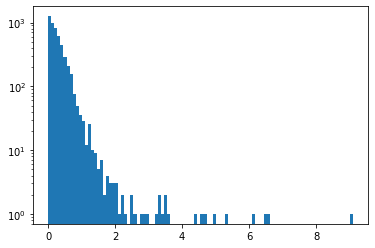

0.29390269770115257 0.38519839204161177


In [9]:
Zscore = np.array(metadata['_rlnparticleselectzscore'])
plt.hist(Zscore, bins=100, log=True)
plt.show()
print(np.mean(Zscore), np.std(Zscore))

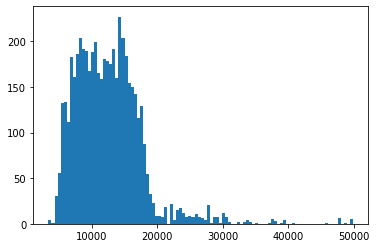

3333.739502 12408.233953110177 5213.635159191951


In [10]:
defocus = np.array(metadata['_rlndefocusu'])
plt.hist(defocus, bins=100, log=False)
plt.show()
print(np.min(defocus),np.mean(defocus), np.std(defocus))

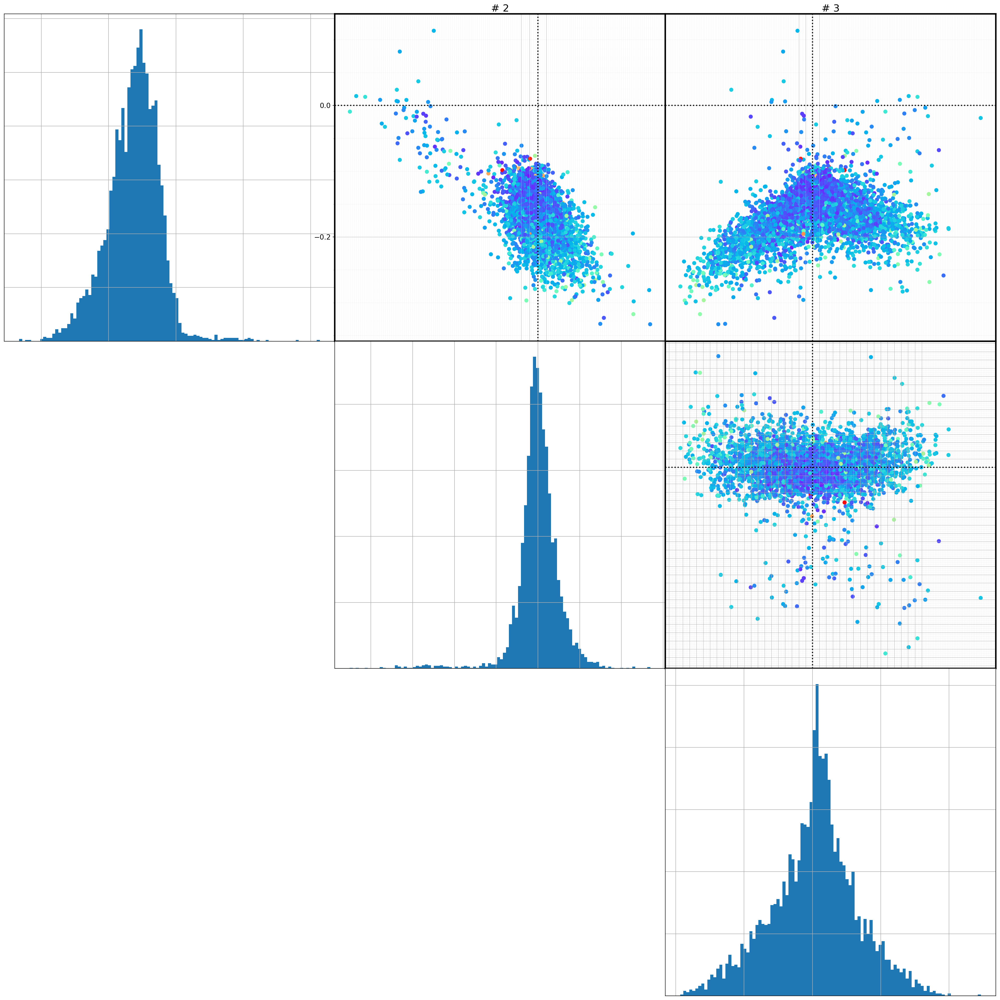

In [11]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=metadata['_rlndefocusu'], 
            figname=KEYWORD+'/latent_space_defocus_true')

In [82]:
center = np.mean(mus,axis=0) #np.zeros(mus.shape) #
U, L, Vt = np.linalg.svd(mus - center, full_matrices=False)

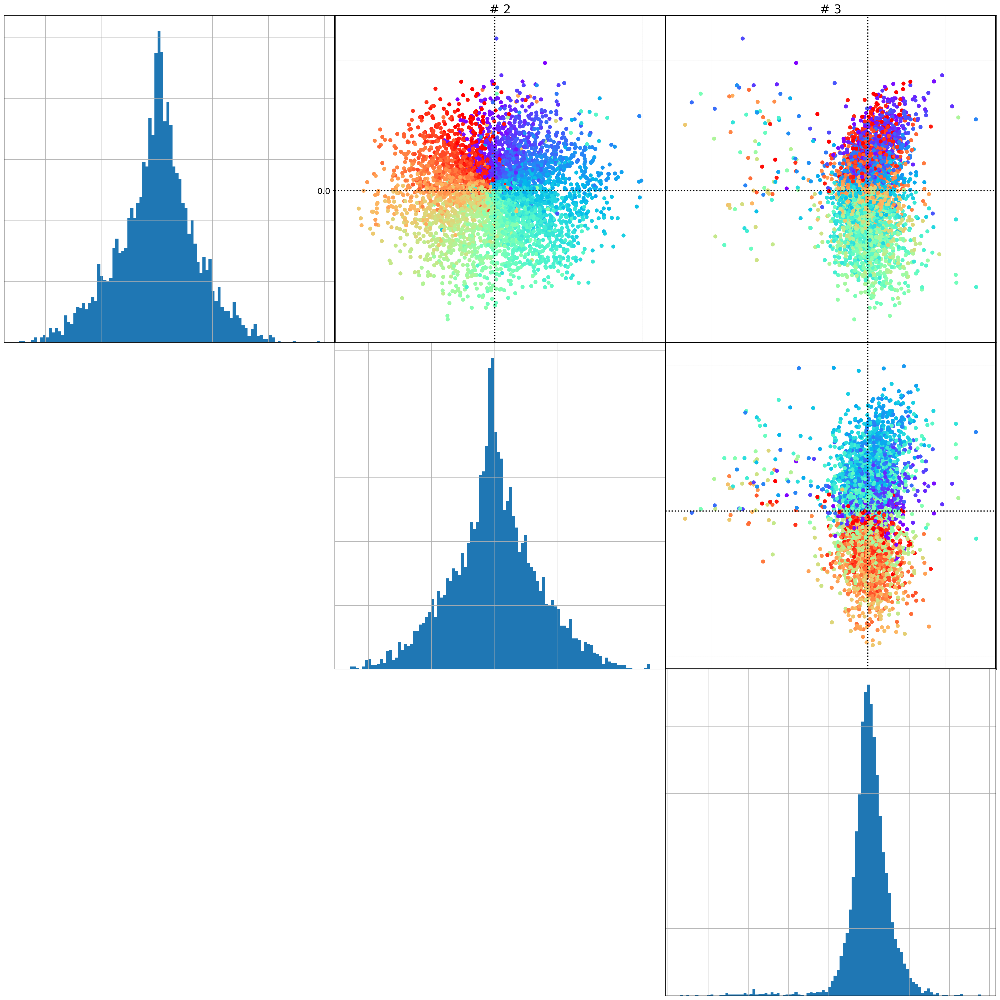

In [83]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=metadata['_rlnanglepsi'], 
            figname=KEYWORD+'/latent_space_pca_defocus_true')

In [84]:
Zscore_set=2

In [85]:
positives = np.where(Zscore<Zscore_set)[0]
negatives = np.where(Zscore>Zscore_set)[0]
print(positives.shape,negatives.shape)

(5090,) (29,)


AUC(robust_covar) = 0.8818643723324977
AUC(isolation_forest) = 0.8824673125127024
AUC(local_outlier_detection) = 0.7627667502201748


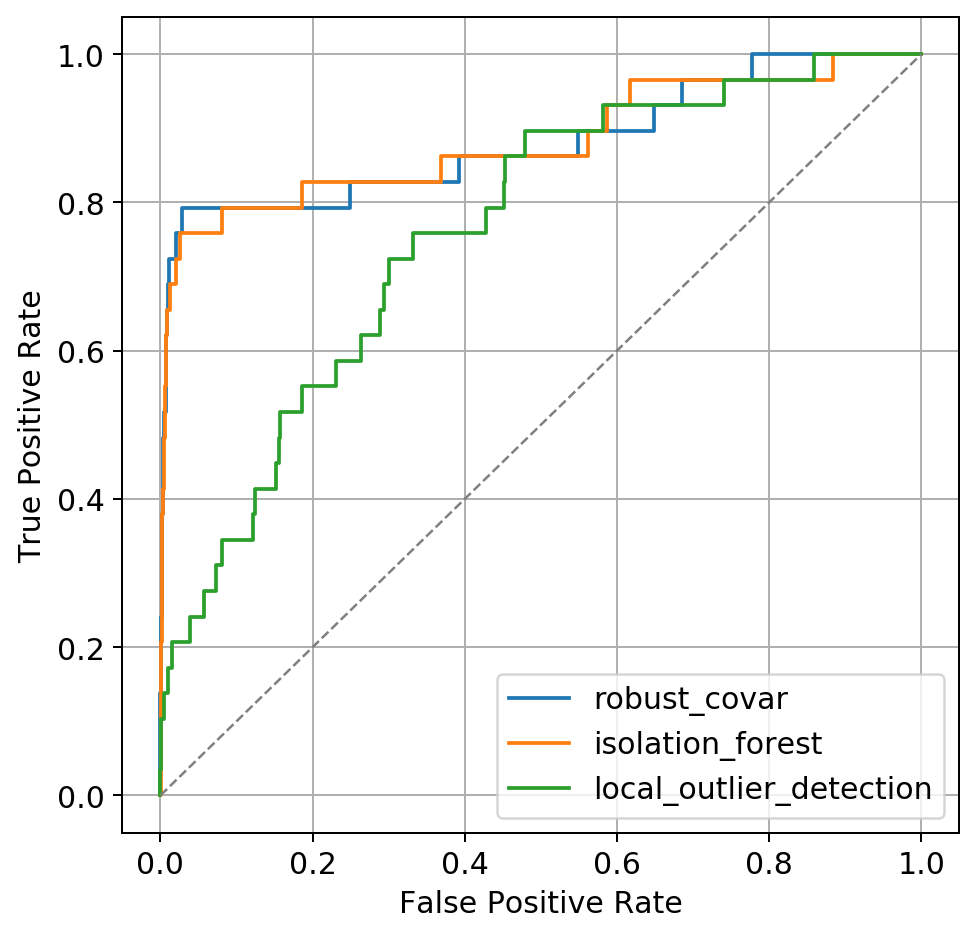

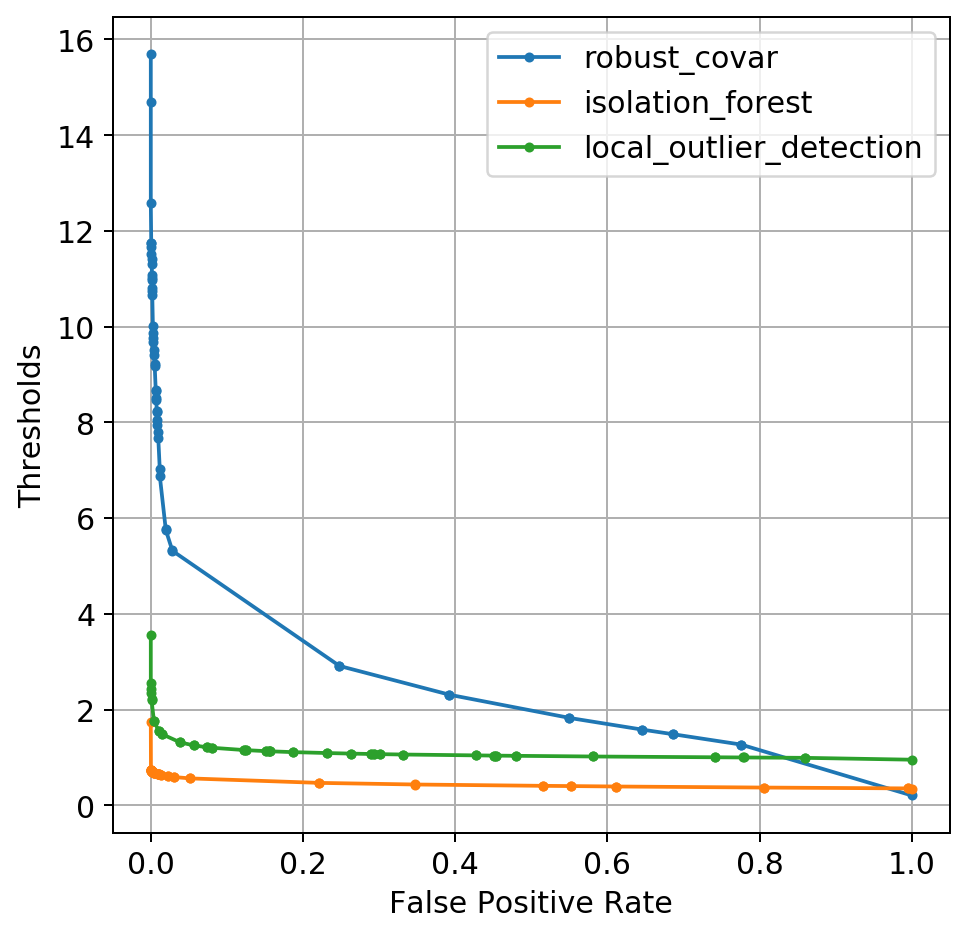

In [86]:
methods = ['robust_covar', 'isolation_forest', 'local_outlier_detection']
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,tpr)
    print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_Zscore'+str(Zscore_set))
#
fig = plt.figure(figsize=(6,6), dpi=180)
plt.xlabel('False Positive Rate')
plt.ylabel('Thresholds')
for method in methods:
    measure, offset, assignment = pred.outlier_measure(mus, method=method)
    fpr, tpr, thresholds = metrics.roc_curve(np.where(Zscore<Zscore_set,0,1), measure)
    plt.plot(fpr,thresholds, '.-')
    #print('AUC({}) = {}'.format(method, metrics.auc(fpr, tpr)))
#plt.plot([0, 1], [0, 1], color='grey', lw=1, linestyle='--')
plt.legend(methods)
plt.grid()
fig.savefig(KEYWORD+'/ROC_thresholds'+str(Zscore_set))

In [87]:
measure, offset, assignment = pred.outlier_measure(mus, method='robust_covar')

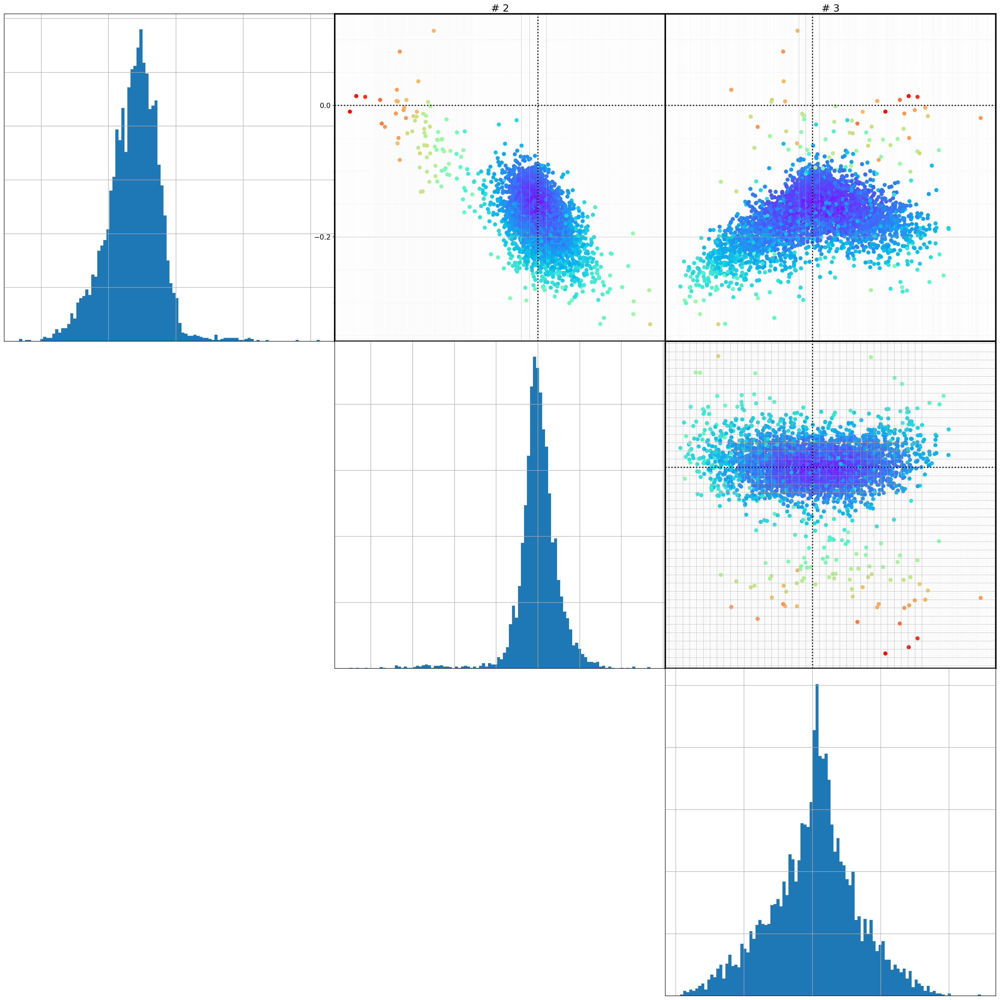

In [24]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=measure, figname=KEYWORD+'/latent_space_robust_covar')

In [88]:
measure_threshold=5

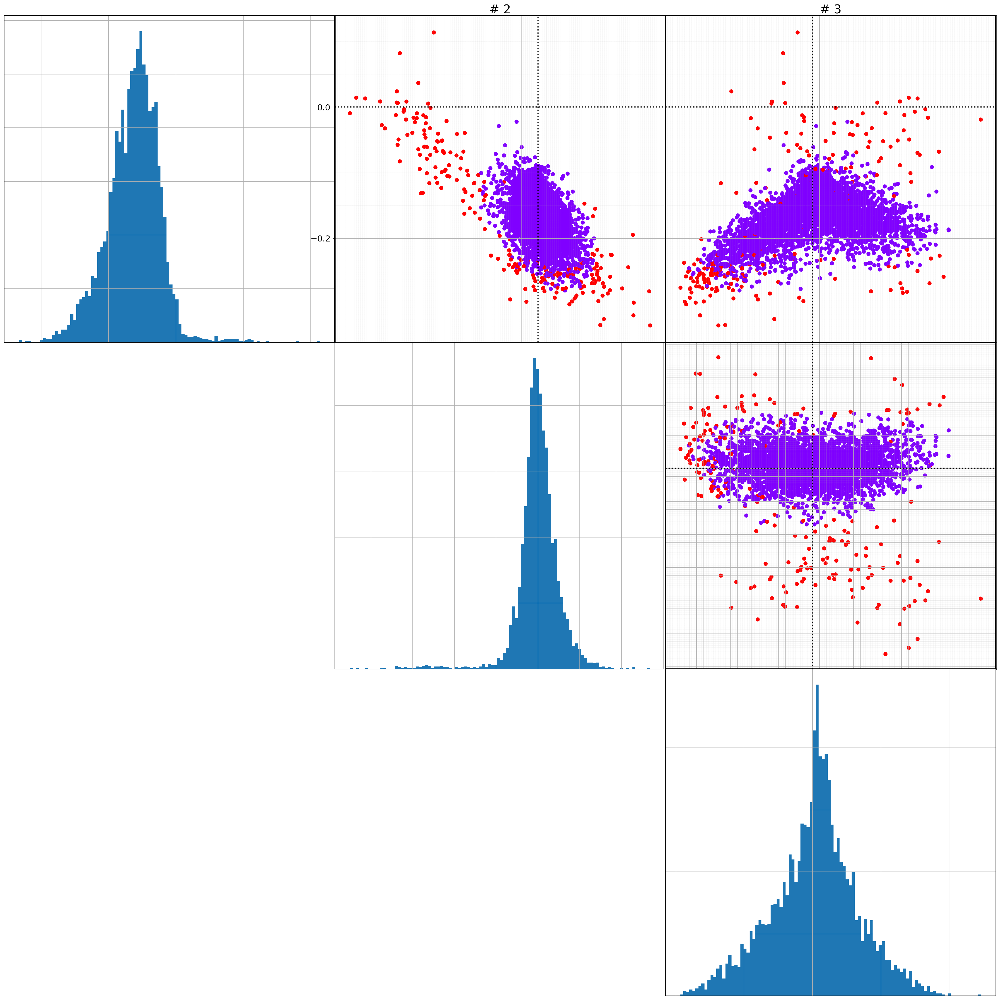

In [89]:
viz.biplots(mus, n=3, show_histo=True, nbins=100, c=np.where(measure<measure_threshold,0,1), figname=KEYWORD+'/latent_space_robust_covar_assigned')

In [90]:
mus_kept = mus[np.where(measure<measure_threshold),:][0,...]
print(mus_kept.shape)
defocus_kept = np.array(metadata['_rlndefocusu'])[np.where(measure<measure_threshold)]
print(defocus_kept.shape)
angle_kept = np.array(metadata['_rlnanglepsi'])[np.where(measure<measure_threshold)]
print(angle_kept.shape)
Zscore_kept = np.array(metadata['_rlnparticleselectzscore'])[np.where(measure<measure_threshold)]
print(Zscore_kept.shape)

(4899, 4)
(4899,)
(4899,)
(4899,)


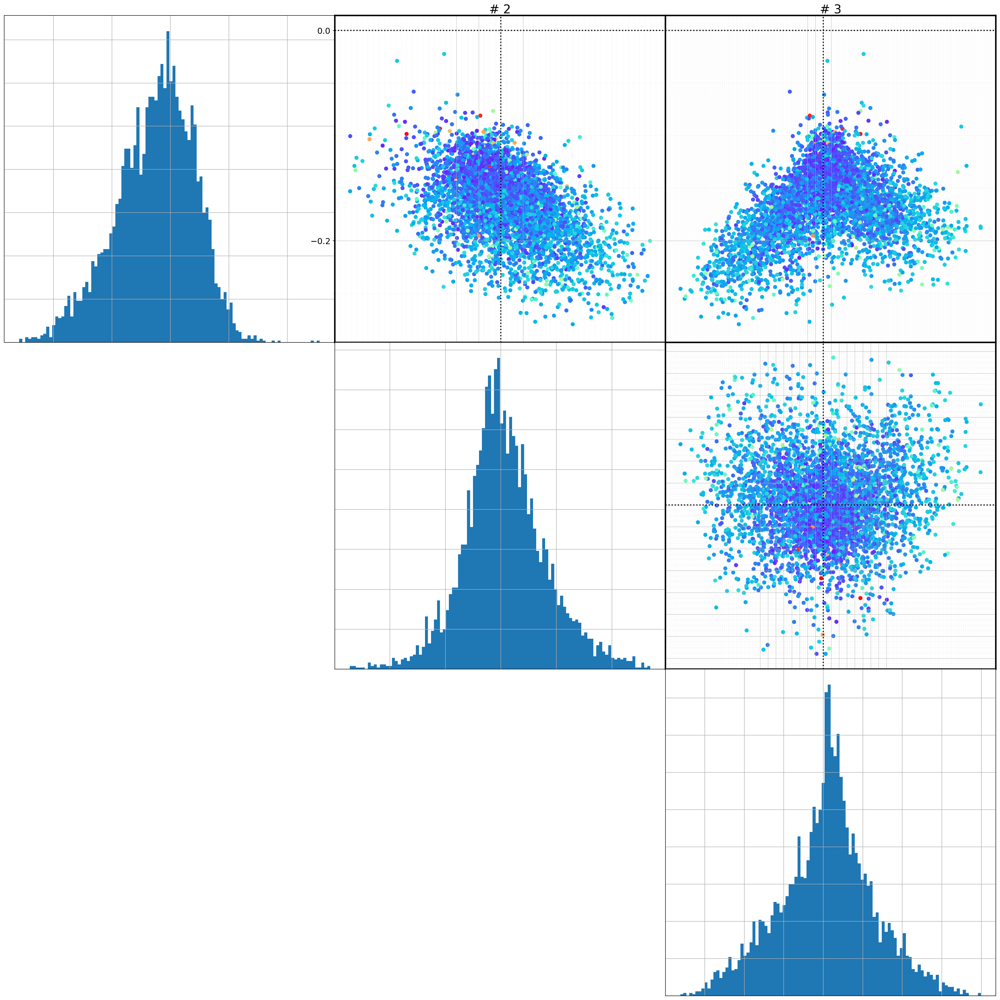

In [91]:
viz.biplots(mus_kept, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [92]:
center = np.mean(mus_kept,axis=0) #np.zeros(mus_kept.shape) #
U, L, Vt = np.linalg.svd(mus_kept - center, full_matrices=False)

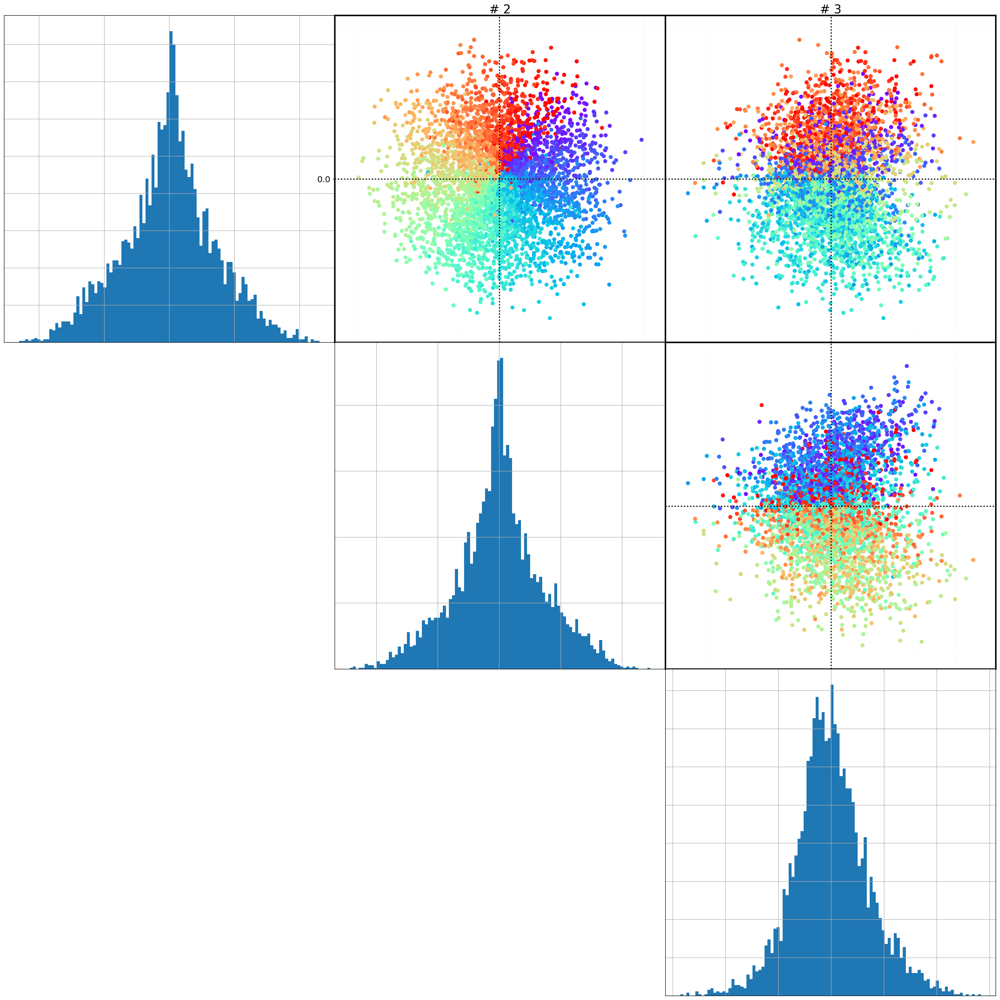

In [93]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=angle_kept)

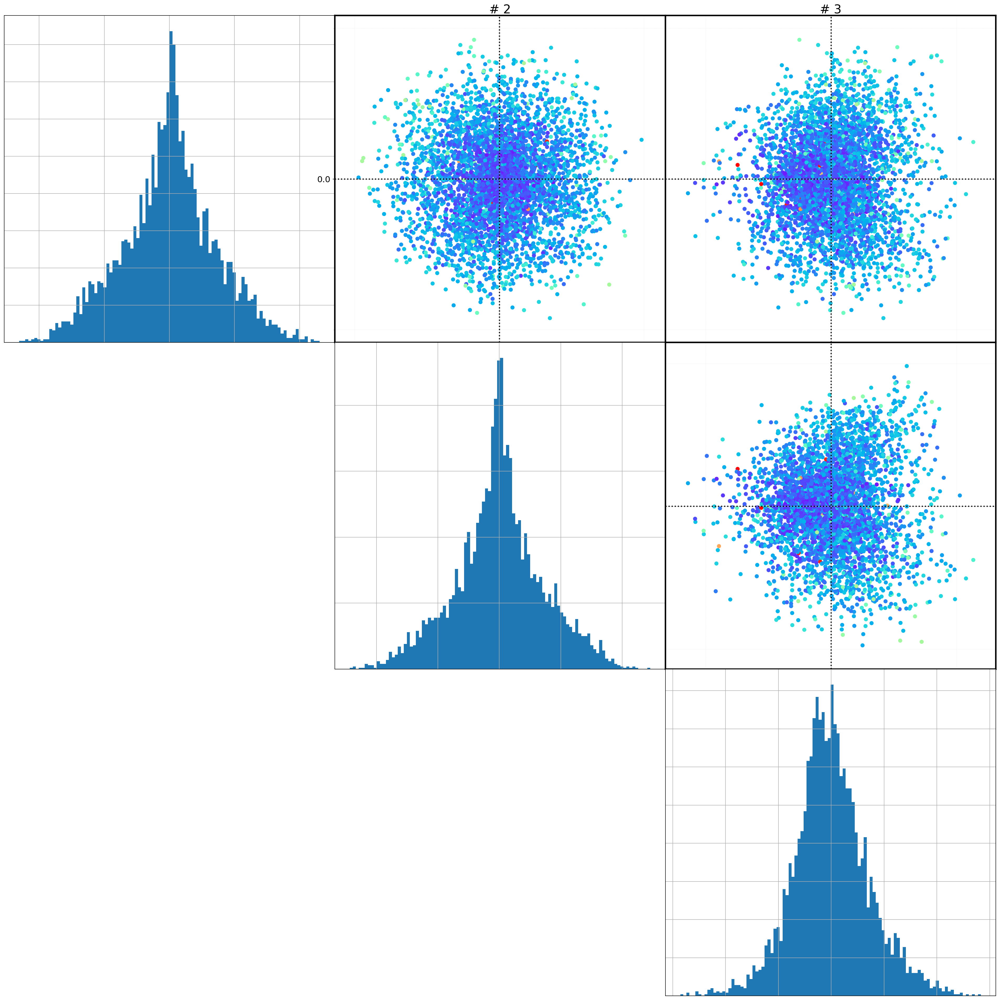

In [94]:
viz.biplots(U, n=3, show_histo=True, nbins=100, c=defocus_kept)

In [95]:
angle_true   = angle_kept + 180
defocus_true = defocus_kept

In [96]:
index = np.where((defocus_kept>5000)  & (defocus_kept < 25000))[0]

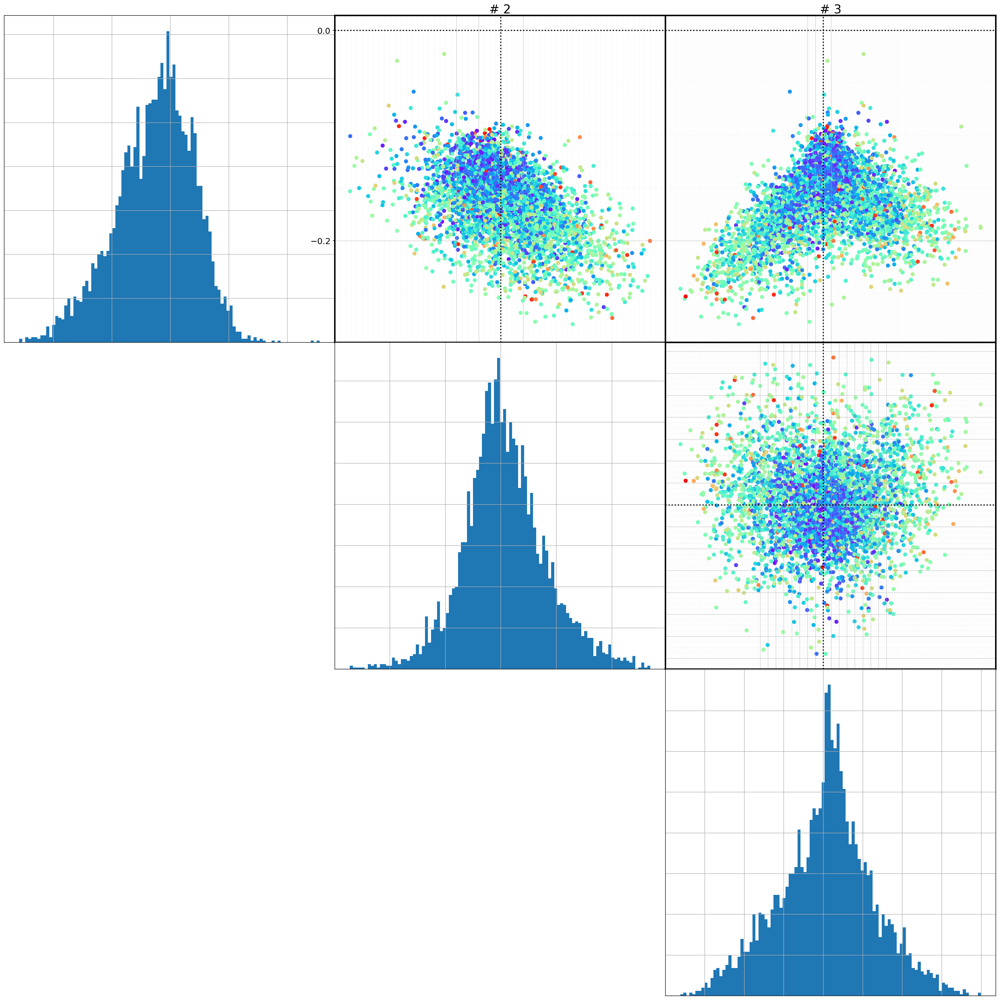

In [97]:
viz.biplots(mus_kept[index,:], n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [98]:
center = np.mean(mus_kept[index,:],axis=0) #np.zeros(mus_kept[index,:].shape) #
U_restricted, L_restricted, Vt_restricted = np.linalg.svd(mus_kept[index,:] - center, full_matrices=False)

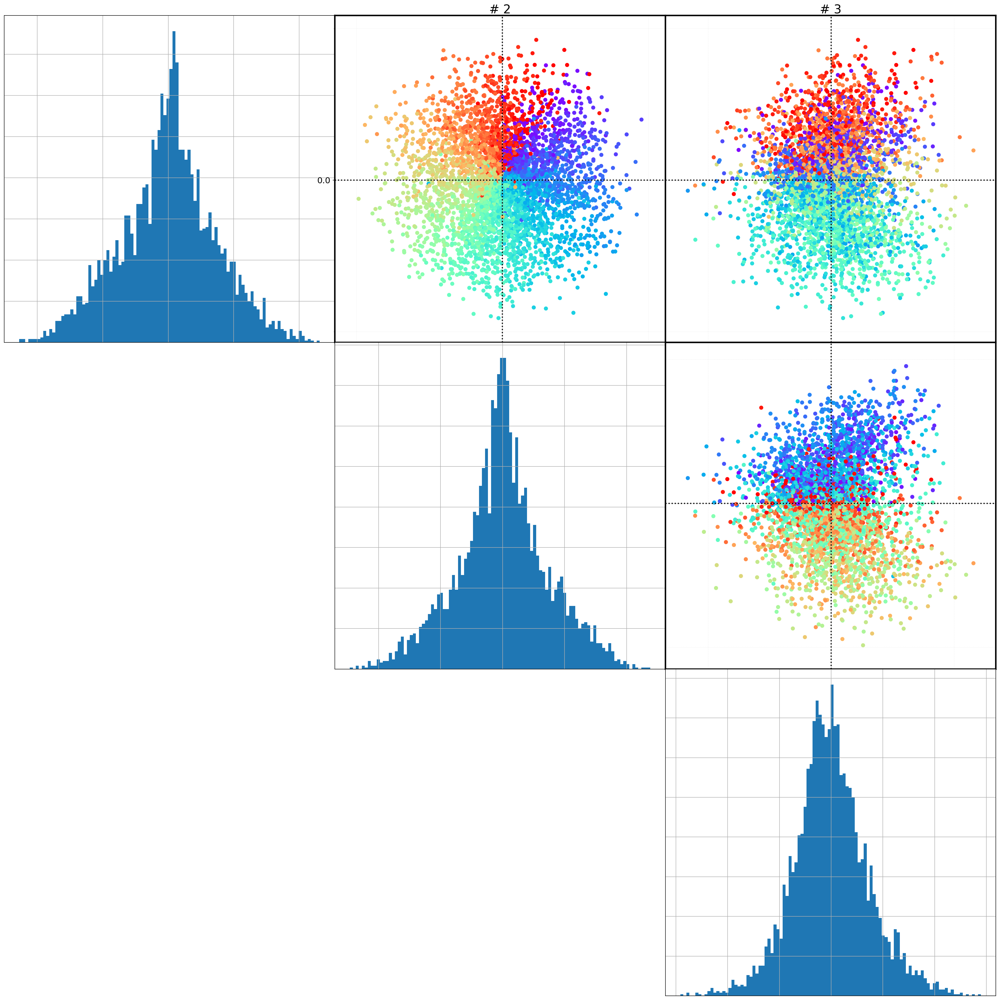

In [99]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=angle_kept[index])

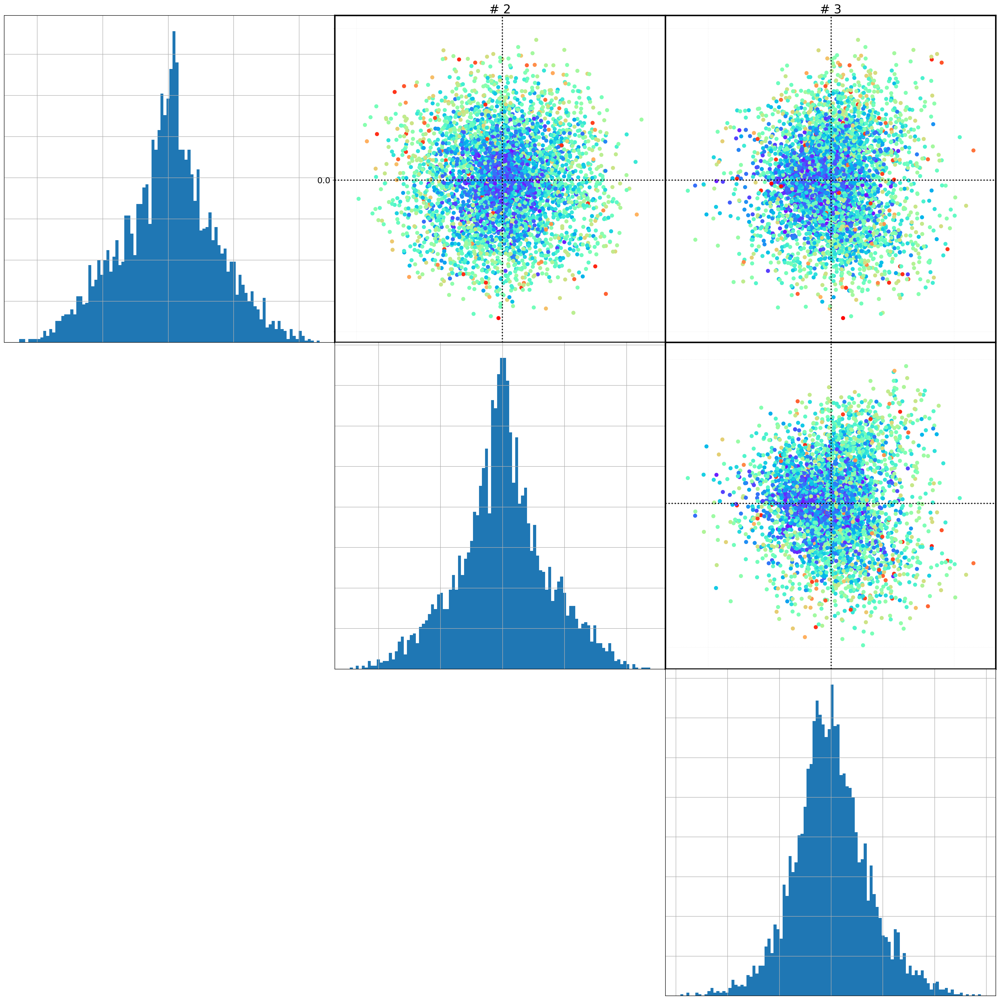

In [100]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=defocus_kept[index])

In [159]:
angle_restricted = angle_kept[index]
defocus_restricted = defocus_kept[index]

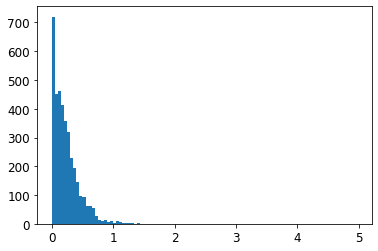

In [70]:
plt.hist(Zscore_kept[index], bins=100)
plt.show()

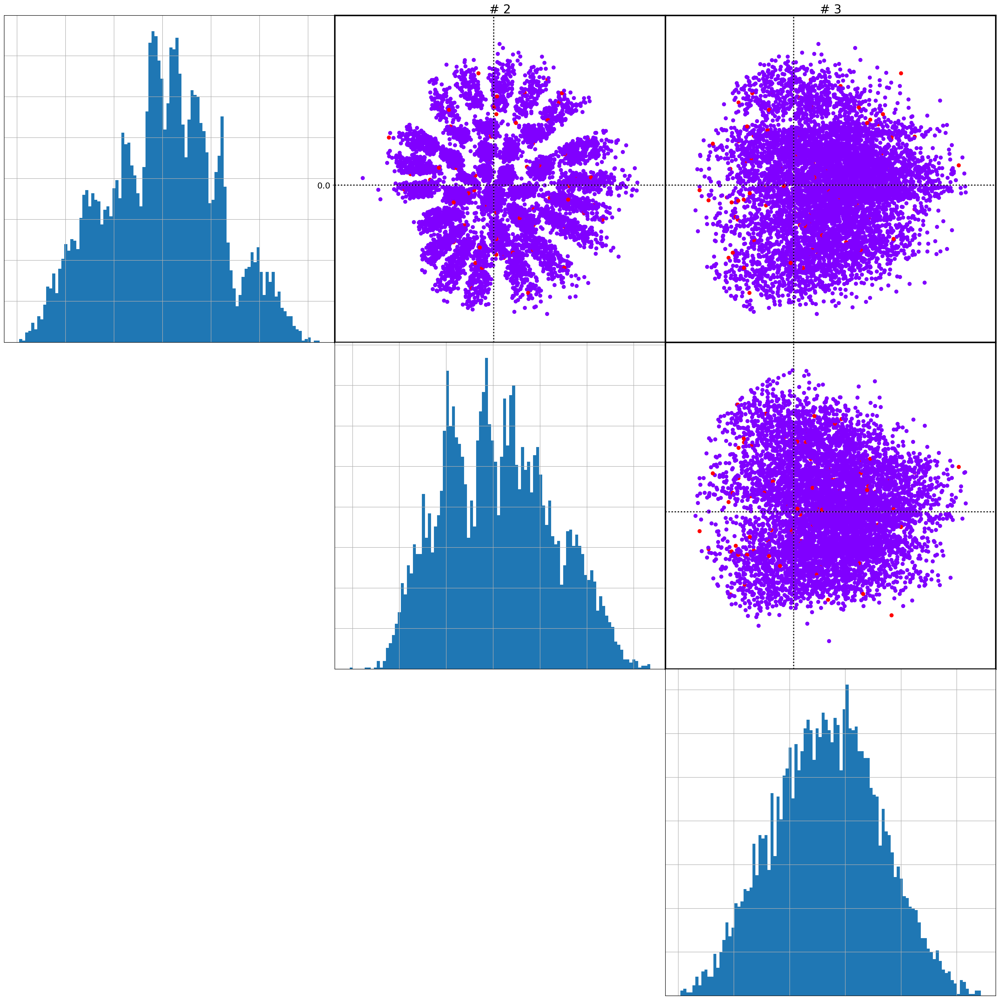

In [148]:
viz.biplots(U_restricted, n=3, show_histo=True, nbins=100, c=np.where(Zscore_kept[index]>1,1,0))

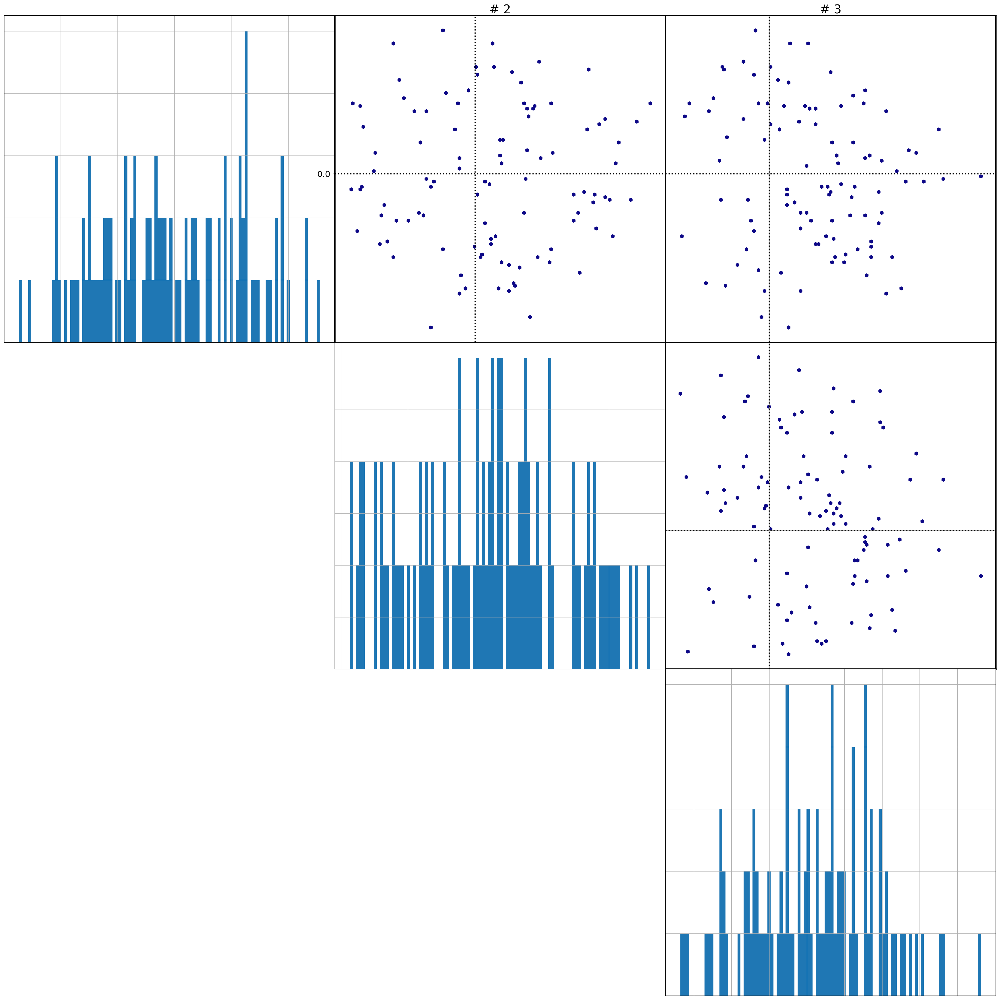

In [149]:
viz.biplots(U_restricted[np.where(Zscore_kept>1)], n=3, show_histo=True, nbins=100)#, c=np.where(Zscore_kept[index]>1,1,0))

In [103]:
angle_pred, defocus_pred = pred.pred2d(U_restricted,  angle_true[index], defocus_true[index], 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

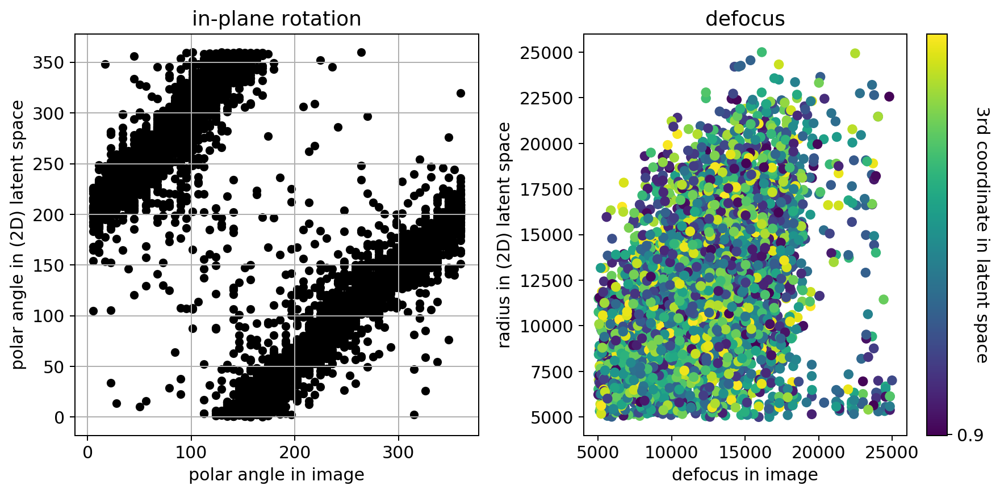

In [104]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_true[index], defocus_true[index], metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

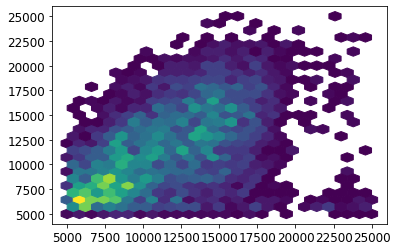

In [105]:
plt.hexbin(defocus_true[index],defocus_pred,gridsize=25,mincnt=1)

offset: 140 angle RMSE = 31.678191147667697
offset: 141 angle RMSE = 31.329458177181124
offset: 142 angle RMSE = 31.009064889151087
offset: 143 angle RMSE = 30.71789805844376
offset: 144 angle RMSE = 30.456795898950237
offset: 145 angle RMSE = 30.226537545767478
offset: 146 angle RMSE = 30.02691962596678
offset: 147 angle RMSE = 29.855470092329963
offset: 148 angle RMSE = 29.716511167283205
offset: 149 angle RMSE = 29.608745806817694
offset: 150 angle RMSE = 29.533830822334032
offset: 151 angle RMSE = 29.492651592168748
offset: 152 angle RMSE = 29.483380895064958
offset: 153 angle RMSE = 29.504810935348154
offset: 154 angle RMSE = 29.5583215581248
offset: 155 angle RMSE = 29.642041864037793
offset: 156 angle RMSE = 29.75662859332327
offset: 157 angle RMSE = 29.904234532074085
offset: 158 angle RMSE = 30.084373699228763
offset: 159 angle RMSE = 30.296465799540503
defocus RMSE = 4245.971513219694


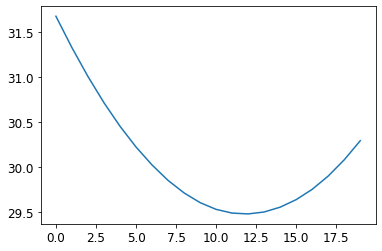

In [113]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_true[index], defocus_true[index], 
                                                angle_offset_range=np.arange(140,160,1))
plt.plot(angle_RMSE_list)

### Remove central disk

In [156]:
U_norm = np.linalg.norm(U_restricted[:,0:2], axis=1)
index_shell = U_norm>np.max(U_norm)/20
print(len(index_shell))
U_shell = U_restricted[index_shell]

4718


In [157]:
U_norm.shape

(4718,)

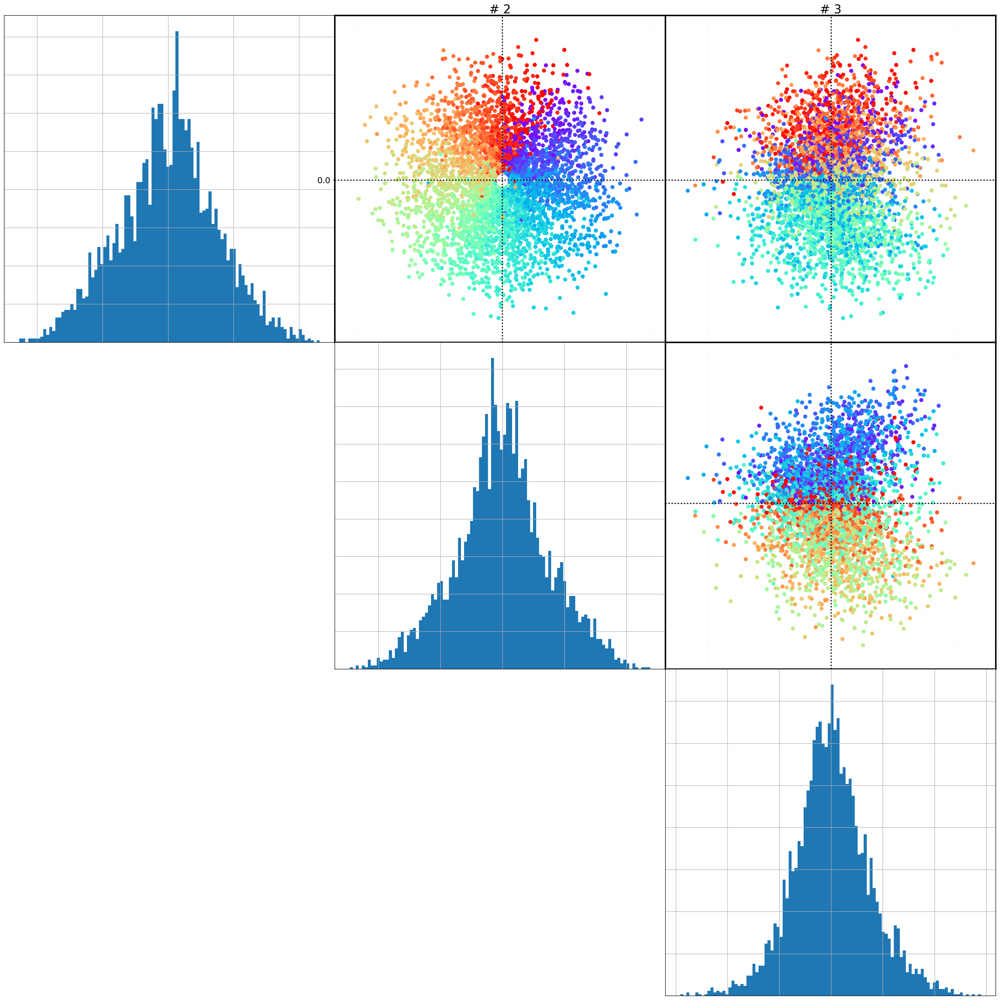

In [158]:
viz.biplots(U_shell, n=3, show_histo=True, nbins=100, c=angle_restricted[index_shell])

In [160]:
angle_pred, defocus_pred = pred.pred2d(U_shell,  angle_restricted[index_shell], defocus_restricted[index_shell], 
                                       angle_pred_sign=1.0,
                                       defocus_min=5000,defocus_max=25000,
                                       do_ellipse=True)

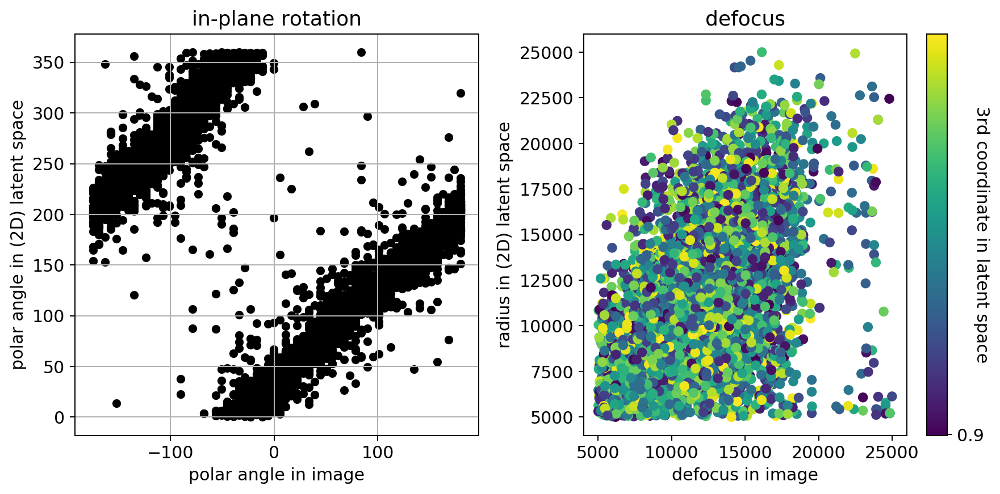

In [161]:
viz.plot_pred2d(angle_pred, defocus_pred, angle_restricted[index_shell], defocus_restricted[index_shell], metadata=angle_pred,
                figname=KEYWORD+'/polar_prediction_ellipse_rest')

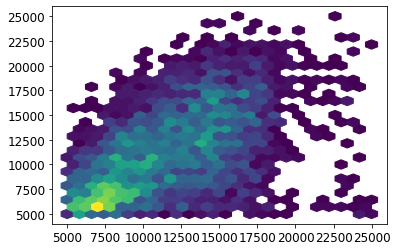

In [162]:
plt.hexbin(defocus_restricted[index_shell],defocus_pred,gridsize=25,mincnt=1)

offset: -40 angle RMSE = 26.507296555552603
offset: -39 angle RMSE = 26.08826909135831
offset: -38 angle RMSE = 25.70133844919972
offset: -37 angle RMSE = 25.34797451896321
offset: -36 angle RMSE = 25.029598995424003
offset: -35 angle RMSE = 24.747562297683398
offset: -34 angle RMSE = 24.503119266110012
offset: -33 angle RMSE = 24.297404534716584
offset: -32 angle RMSE = 24.131408600095718
offset: -31 angle RMSE = 24.003424199514654
offset: -30 angle RMSE = 23.915766350096376
offset: -29 angle RMSE = 23.869716934515342
offset: -28 angle RMSE = 23.864108858031198
offset: -27 angle RMSE = 23.89840351692068
offset: -26 angle RMSE = 23.972104729102686
offset: -25 angle RMSE = 24.086060224532336
offset: -24 angle RMSE = 24.24076708843918
offset: -23 angle RMSE = 24.435451307663822
offset: -22 angle RMSE = 24.669166437374116
offset: -21 angle RMSE = 24.940815214707822
defocus RMSE = 4066.2714984083527


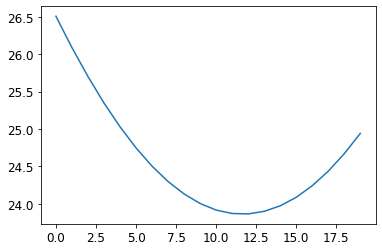

In [166]:
angle_RMSE_list, defocus_RMSE = pred.pred2d_mse(angle_pred, defocus_pred, 
                                                angle_restricted[index_shell], defocus_restricted[index_shell], 
                                                angle_offset_range=np.arange(-40,-20,1))
plt.plot(angle_RMSE_list)